## L'extraction des données du site web

### Creation de ma base de données pour son stockage

In [60]:
import sqlite3

# --- Connexion à la base de données ---
conn = sqlite3.connect('books.db')
cursor = conn.cursor()

# --- Création de la table (si elle n'existe pas) ---
cursor.execute('''
    CREATE TABLE IF NOT EXISTS books (
        title TEXT,
        price TEXT,
        Description TEXT
    )''')
conn.commit()


In [61]:
from bs4 import BeautifulSoup
import requests

base_url = "https://books.toscrape.com/catalogue/"
page_url = "category/books_1/index.html"

while page_url:
    url = base_url + page_url
    response = requests.get(url)
    soup = BeautifulSoup(response.text, 'html.parser')
    books = soup.find_all('article', class_='product_pod')

    for book in books:
        href = book.h3.a['href']
        book_url = base_url + href.replace('../', '')
        book_response = requests.get(book_url)
        print(f"URL du livre: {book_url}")
        print(f"Statut de la réponse: {book_response.status_code}")
        book_soup = BeautifulSoup(book_response.text, 'html.parser')
        print(book_soup.prettify())
        
        title = book_soup.h1.text
        price = book_soup.find('p', class_='price_color').text
        description = book_soup.find('meta', attrs={'name': 'description'})['content'].strip()
        #availability = book_soup.find('p', class_='instock availability').text.strip()
        #rating = book_soup.find('p', class_='star-rating')['class'][1]
        
         # --- Insertion des données dans la base de données ---
        cursor.execute('''
            INSERT INTO books (title, price, Description)
            VALUES (?, ?, ?)
        ''', (title, price, description))
        conn.commit()

        print(f'Livre inséré : {title}')

    next_btn = soup.find('li', class_='next')
    if next_btn:
        page_url = next_btn.a['href']
    else:
        break

# --- Fermeture de la connexion ---
conn.close()
print("Scraping terminé. Toutes les données ont été sauvegardées dans books.db.")

URL du livre: https://books.toscrape.com/catalogue/a-light-in-the-attic_1000/index.html
Statut de la réponse: 200
<!DOCTYPE html>
<!--[if lt IE 7]>      <html lang="en-us" class="no-js lt-ie9 lt-ie8 lt-ie7"> <![endif]-->
<!--[if IE 7]>         <html lang="en-us" class="no-js lt-ie9 lt-ie8"> <![endif]-->
<!--[if IE 8]>         <html lang="en-us" class="no-js lt-ie9"> <![endif]-->
<!--[if gt IE 8]><!-->
<html class="no-js" lang="en-us">
 <!--<![endif]-->
 <head>
  <title>
   A Light in the Attic | Books to Scrape - Sandbox
  </title>
  <meta content="text/html; charset=utf-8" http-equiv="content-type"/>
  <meta content="24th Jun 2016 09:29" name="created"/>
  <meta content="
    It's hard to imagine a world without A Light in the Attic. This now-classic collection of poetry and drawings from Shel Silverstein celebrates its 20th anniversary with this special edition. Silverstein's humorous and creative verse can amuse the dowdiest of readers. Lemon-faced adults and fidgety kids sit still 

## Praitraitement des données 

In [62]:
import pandas as pd
import sqlite3
import re
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

# --- 1. Connexion à la base de données et chargement dans un DataFrame ---
conn = sqlite3.connect('books.db')
query = "SELECT * FROM books"
df = pd.read_sql_query(query, conn)
conn.close()

# Afficher les 5 premières lignes du DataFrame
print("DataFrame initial :")
print(df.head())
print("\n" + "="*50 + "\n")

# --- 2. Fonctions de prétraitement ---
# On va créer une fonction qui regroupe toutes les étapes
def preprocess_text(text):
    # 1. Normalisation : tout en minuscules
    text = text.lower()
    
    # 2. Nettoyage : suppression de la ponctuation, chiffres, etc.
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    
    # 3. Tokenisation
    tokens = word_tokenize(text, language='english')
   
    
    # 4. Suppression des mots vides
    stop_words = set(stopwords.words('english'))
    
    tokens = [word for word in tokens if word not in stop_words]
    
    # On retourne une chaîne de caractères pour faciliter la vectorisation ultérieure
    return " ".join(tokens)



DataFrame initial :
                                   title    price  \
0                   A Light in the Attic  Â£51.77   
1                     Tipping the Velvet  Â£53.74   
2                             Soumission  Â£50.10   
3                          Sharp Objects  Â£47.82   
4  Sapiens: A Brief History of Humankind  Â£54.23   

                                         Description  
0  It's hard to imagine a world without A Light i...  
1  "Erotic and absorbing...Written with starling ...  
2  Dans une France assez proche de la nÃ´tre, un ...  
3  WICKED above her hipbone, GIRL across her hear...  
4  From a renowned historian comes a groundbreaki...  




In [63]:
df.shape

(1000, 3)

In [64]:
# --- 3. Application de la fonction à la colonne 'title' ---
data = df.copy()
print(data.shape)
titre = data.columns
for col in titre:
    if col in ['title', 'Description']:
        data[col] = data[col].apply(preprocess_text)

# Afficher les résultats
print("DataFrame avec les titres prétraités :")
print(data.shape)

# Changement des types de données
# 1. Nettoyage de la colonne 'price'
# Remplacer d'abord le caractère d'encodage 'Â' (s'il existe)
data['price'] = data['price'].str.replace('Â', '', regex=False)
data['price'] = data['price'].str.replace('£', '', regex=False)
data['price'] = data['price'].str.replace(',', '.', regex=False) # Remplacer les virgules par des points si nécessaire
data['price'] = data['price'].astype(float)
data['Description'] = data['Description'].astype('string')
data['title'] = data['title'].astype('string')


# affichage
print("DataFrame avec les types de données modifiés :")
print(data.dtypes)
print(data.shape)

print("\n" + "="*50 + "\n")

(1000, 3)


DataFrame avec les titres prétraités :
(1000, 3)
DataFrame avec les types de données modifiés :
title          string[python]
price                 float64
Description    string[python]
dtype: object
(1000, 3)




In [65]:
data.shape

(1000, 3)

## Vectorization

In [66]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer


# 1. Combinaison des colonnes 'title' et 'Description'
data['combined_text'] = data['title'].fillna('') + ' ' + data['Description'].fillna('')
# 2. Vectorisation avec TF-IDF
# Créer un TfidfVectorizer
tfidf_vectorizer = TfidfVectorizer(max_features=5000) # Limiter le nombre de features pour l'efficacité

# Appliquer le vectoriseur à la nouvelle colonne 'combined_text'
tfidf_matrix = tfidf_vectorizer.fit_transform(data['combined_text'])

# Afficher la taille de la matrice vectorisée
# La forme est (nombre de documents, nombre de features)
print("Matrice TF-IDF pour les titres et descriptions combinés :")
print(tfidf_matrix.shape)

# Afficher les 5 premières lignes de la matrice (en format dense pour la lisibilité)
print("\nExemple de la matrice TF-IDF (3premières lignes) :")
print(tfidf_matrix[:30].toarray())


Matrice TF-IDF pour les titres et descriptions combinés :
(1000, 5000)

Exemple de la matrice TF-IDF (3premières lignes) :
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


#### L'embedding

In [113]:
from sentence_transformers import SentenceTransformer

# Charger un modèle d'embeddings pré-entraîné
#model = SentenceTransformer('distilbert-base-nli-mean-tokens')
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# Générer les embeddings pour la colonne 'processed_title'
sentence_embeddings = model.encode(data['combined_text'].tolist(), show_progress_bar=True  )

# Afficher la taille des embeddings
print("Embeddings de phrases :")
print(sentence_embeddings.shape)
# La forme sera (nombre de documents, dimension du vecteur)

Batches: 100%|██████████| 32/32 [01:06<00:00,  2.06s/it]

Embeddings de phrases :
(1000, 384)


In [114]:
sentence_embeddings.shape  # Afficher les 5 premiers embeddings pour vérification

(1000, 384)

In [ ]:
from sentence_transformers import SentenceTransformer
import pandas as pd
import numpy as np

# Supposons que 'data' est votre DataFrame avec les colonnes prétraitées.
# C'est l'étape après le prétraitement du texte.
# ... (votre code de prétraitement du texte) ...
# data['combined_text'] = data['title'].fillna('') + ' ' + data['Description'].fillna('')

# 1. Chargement du modèle d'embeddings pré-entraîné
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# 2. Génération des embeddings pour la colonne 'combined_text'
# La fonction 'encode' transforme chaque texte en un vecteur numérique.
sentence_embeddings = model.encode(data['combined_text'].tolist(), show_progress_bar=True)
# 3. Affichage de la taille des embeddings
print("Embeddings de phrases :")
print(sentence_embeddings.shape)
# La forme sera (nombre de documents, dimension du vecteur)

# 4. Ajout des embeddings au DataFrame
# Convertir la matrice d'embeddings en une liste de vecteurs
data['embedding'] = list(sentence_embeddings)

# 5. Affichage du DataFrame mis à jour pour vérification
print("\nDataFrame avec la nouvelle colonne 'embedding':")
print(data[['title', 'embedding']].head())

In [156]:
print(type(sentence_embeddings))
print(type(np.array(data['embedding'])))


<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [ ]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
#from sklearn.preprocessing import StandardScaler
K = range(2, 40)
fits = []
score = []


for k in K:
    # train the model for current value of k on training data
    model = KMeans(n_clusters = k, random_state = 42, init="k-means++").fit(sentence_embeddings)
    
    # append the model to fits
    fits.append(model)
    
    # Append the silhouette score to scores
    score.append(silhouette_score(sentence_embeddings, model.labels_, metric='euclidean'))



ValueError: setting an array element with a sequence.

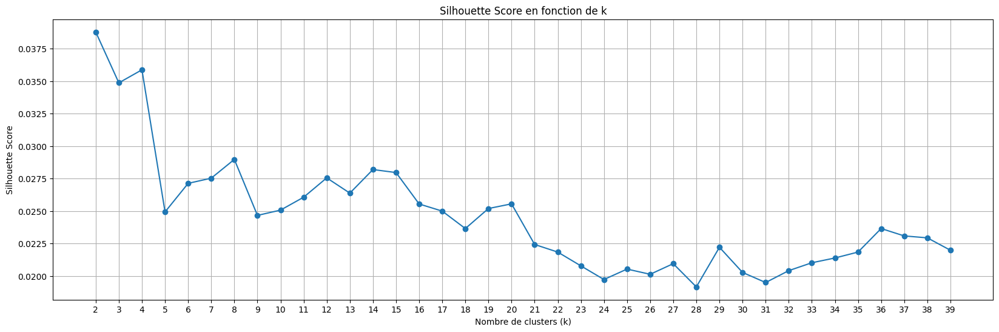

In [134]:
import matplotlib.pyplot as plt
# Tracer la silhouette score en fonction de k
plt.figure(figsize=(20, 6))
plt.plot(K, score, marker='o')
plt.title('Silhouette Score en fonction de k')
plt.xlabel('Nombre de clusters (k)')
plt.ylabel('Silhouette Score')
plt.xticks(K)
plt.grid()
plt.show()

In [135]:
model = KMeans(n_clusters=5, random_state=42, init ="k-means++")
model.fit(sentence_embeddings)
# Afficher les labels des clusters



,n_clusters,5
,init,'k-means++'
,n_init,'auto'
,max_iter,300
,tol,0.0001
,verbose,0
,random_state,42
,copy_x,True
,algorithm,'lloyd'


In [136]:
sentence_embeddings.shape

(1000, 384)

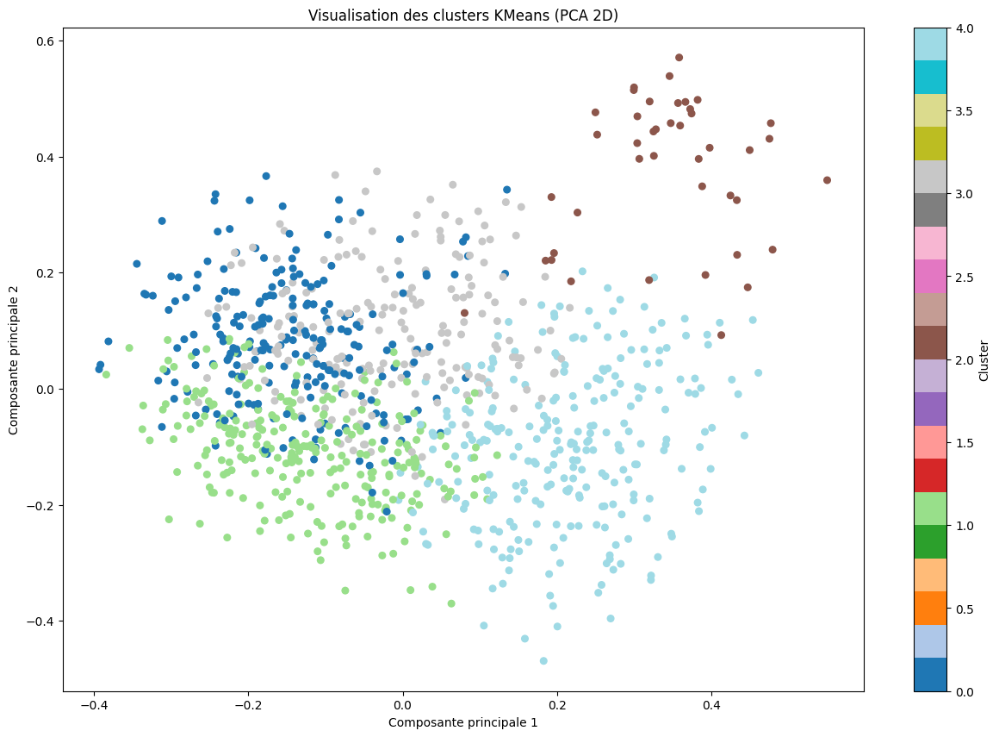

In [137]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Réduction de dimension à 2D pour la visualisation
pca = PCA(n_components=3)
reduced_embeddings = pca.fit_transform(sentence_embeddings)

# Prédire les labels des clusters
labels = model.labels_

plt.figure(figsize=(15, 10))
scatter = plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], c=labels, cmap='tab20', s=30)
plt.title("Visualisation des clusters KMeans (PCA 2D)")
plt.xlabel("Composante principale 1")
plt.ylabel("Composante principale 2")
plt.colorbar(scatter, label='Cluster')
plt.show()

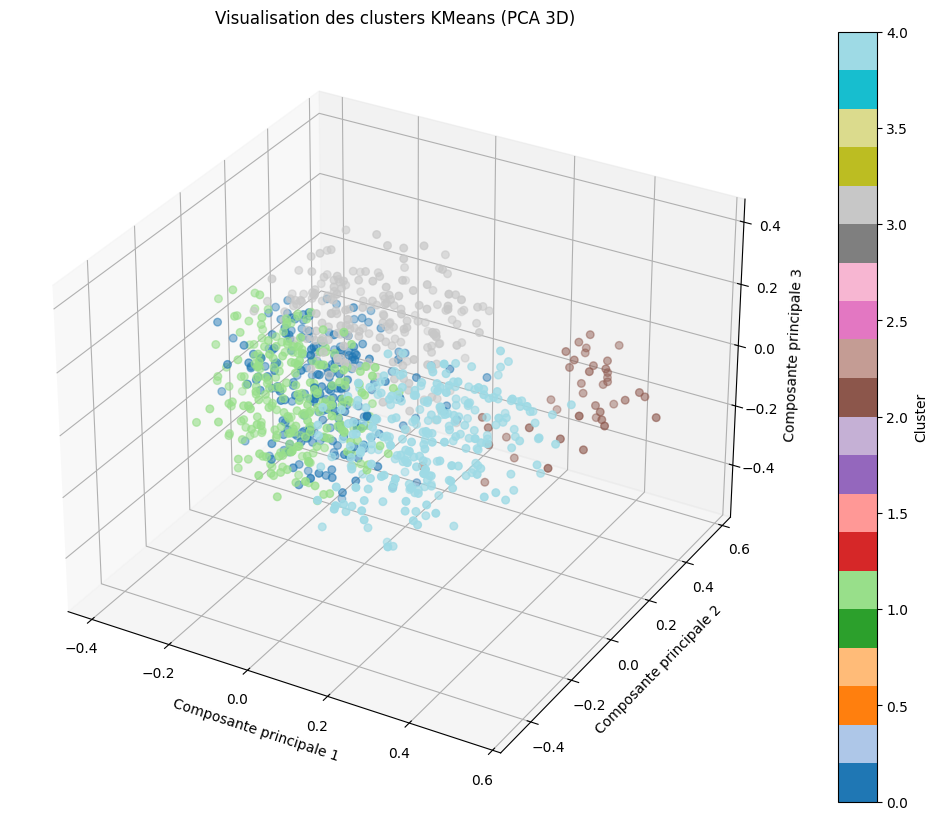

In [138]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # Nécessaire pour la 3D

# Réduction de dimension à 3D pour la visualisation
pca = PCA(n_components=3)
reduced_embeddings = pca.fit_transform(sentence_embeddings)

# Prédire les labels des clusters
labels = model.labels_

fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(
    reduced_embeddings[:, 0],
    reduced_embeddings[:, 1],
    reduced_embeddings[:, 2],
    c=labels,
    cmap='tab20',
    s=30
)
ax.set_title("Visualisation des clusters KMeans (PCA 3D)")
ax.set_xlabel("Composante principale 1")
ax.set_ylabel("Composante principale 2")
ax.set_zlabel("Composante principale 3")
fig.colorbar(scatter, label='Cluster')
plt.show()

## La classification

In [139]:
# Supposons que 'data' est votre DataFrame avec les informations sur les livres
# et que 'model' est votre modèle KMeans entraîné

# Récupérer les labels de cluster pour chaque document
cluster_labels = model.labels_

# Ajouter ces labels à une nouvelle colonne dans le DataFrame
data['cluster'] = cluster_labels

# Afficher les 5 premières lignes pour vérifier
print(data[['title', 'cluster']].head())


                             title  cluster
0                      light attic        0
1                   tipping velvet        0
2                       soumission        4
3                    sharp objects        3
4  sapiens brief history humankind        4


In [140]:
# Obtenir le nombre total de clusters (vous avez 14)
num_clusters = data['cluster'].nunique()

print(f"Écriture de 5 exemples de livres pour chaque cluster dans 'cluster_data.txt'\n")

# Ouvrir le fichier en mode écriture ('w') à l'extérieur de la boucle
# pour s'assurer qu'il est propre avant de commencer
with open('cluster_data.txt', 'w', encoding='utf-8') as f:
    # Boucler sur chaque cluster
    for i in range(num_clusters):
        # Écrire l'en-tête du cluster
        f.write(f"--- Cluster {i} ---\n")
        f.write("="*50 + "\n")

        # Filtrer le DataFrame pour ne garder que les livres du cluster actuel
        cluster_data = data[data['cluster'] == i]
        
        # Écrire les 5 premiers livres de ce cluster dans le fichier
        # en utilisant to_string() pour un formatage lisible
        f.write(cluster_data[['title', 'Description']].head().to_string(index=False))
        
        # Ajouter une ligne de séparation
        f.write("\n" + "="*50 + "\n")

print("Le fichier 'cluster_data.txt' a été créé avec succès.")

Écriture de 5 exemples de livres pour chaque cluster dans 'cluster_data.txt'

Le fichier 'cluster_data.txt' a été créé avec succès.


In [141]:
import pandas as pd

# Supposons que 'data' est votre DataFrame et qu'il a une colonne 'cluster'
# et que 'dict_classification' est votre dictionnaire de catégories.

# Dictionnaire des catégories
dict_classification = {
    0: "classic children's literature and general fiction",
    1: "non-fiction, history, and contemporary literature.",
    2: "fantasy, science fiction, and dystopian fiction.",
    3: "classic novels and historical fiction",
    4: "young adult literature and fantasy.",
    5: "modern classic literature.",
    6: "thriller and mystery.",
    7: "non-fiction, psychology, and self-help",
    8: "contemporary romance.",
    9: "science fiction and space opera",
    10: "fables and philosophical novels.",
    11: "children's literature and picture books.",
    12: "comedy and humorous science fiction.",
    13: "epic fantasy."
}

# Utiliser la méthode .map() pour remplacer les numéros de cluster
data['cluster_category'] = data['cluster'].map(dict_classification)

# Afficher les 5 premières lignes pour vérifier le résultat
print(data[['title', 'cluster', 'cluster_category']].head())

# Afficher la distribution des nouvelles catégories
print("\nDistribution des livres par nouvelle catégorie :")
print(data['cluster_category'].value_counts())

                             title  cluster  \
0                      light attic        0   
1                   tipping velvet        0   
2                       soumission        4   
3                    sharp objects        3   
4  sapiens brief history humankind        4   

                                    cluster_category  
0  classic children's literature and general fiction  
1  classic children's literature and general fiction  
2                young adult literature and fantasy.  
3              classic novels and historical fiction  
4                young adult literature and fantasy.  

Distribution des livres par nouvelle catégorie :
cluster_category
non-fiction, history, and contemporary literature.    266
young adult literature and fantasy.                   259
classic children's literature and general fiction     229
classic novels and historical fiction                 204
fantasy, science fiction, and dystopian fiction.       42
Name: count, dtype: int64


In [142]:
data.head()


,title,price,Description,combined_text,cluster,cluster_category,embedding
0,light attic,51.77,hard imagine world without light attic nowclas...,light attic hard imagine world without light a...,0,classic children's literature and general fiction,"[-0.0016520097, -0.06349103, 0.03749519, 0.011..."
1,tipping velvet,53.74,erotic absorbingwritten starling powerthe new ...,tipping velvet erotic absorbingwritten starlin...,0,classic children's literature and general fiction,"[0.020146599, -0.07992482, 0.057685845, 0.0311..."
2,soumission,50.10,dans une france assez proche de la ntre un hom...,soumission dans une france assez proche de la ...,4,young adult literature and fantasy.,"[0.00068157096, 0.052752566, -0.0528796, -0.06..."
3,sharp objects,47.82,wicked hipbone girl across heart words like ro...,sharp objects wicked hipbone girl across heart...,3,classic novels and historical fiction,"[0.047882315, -0.08230219, 0.01754349, 0.01298..."
4,sapiens brief history humankind,54.23,renowned historian comes groundbreaking narrat...,sapiens brief history humankind renowned histo...,4,young adult literature and fantasy.,"[-0.03729299, 0.014173442, 0.002418566, 0.0136..."


## Le knn

/tmp/ipykernel_4647/2898823968.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=cluster_counts.index, y=cluster_counts.values, palette='viridis')


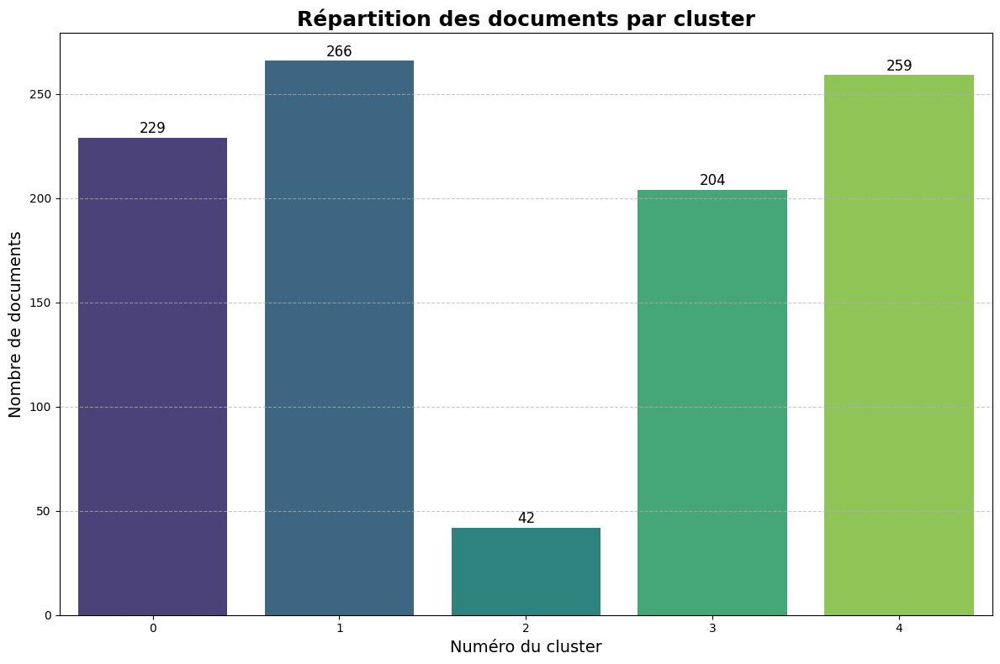

In [143]:
# le diagramme de repartition des clusters 
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Supposons que 'data' est votre DataFrame et qu'il a une colonne 'cluster'
# Création d'un DataFrame de démonstration pour que le code soit exécutable
# 1. Préparation des données
# Compter le nombre d'éléments dans chaque cluster
cluster_counts = data['cluster'].value_counts().sort_index()

# 2. Création du graphique
plt.figure(figsize=(12, 8))
sns.barplot(x=cluster_counts.index, y=cluster_counts.values, palette='viridis')

# 3. Ajout des titres et labels pour une meilleure lisibilité
plt.title('Répartition des documents par cluster', fontsize=18, fontweight='bold')
plt.xlabel('Numéro du cluster', fontsize=14)
plt.ylabel('Nombre de documents', fontsize=14)
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Ajouter les valeurs exactes au-dessus de chaque barre
for index, value in enumerate(cluster_counts.values):
    plt.text(index, value + 0.5, str(value), ha='center', va='bottom', fontsize=12)

# Afficher le graphique
plt.tight_layout()
plt.show()

In [144]:
sentence_embeddings.shape

(1000, 384)

In [145]:
# 1. Importations
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.pipeline import Pipeline # Importation du Pipeline

# 2. Chargement des données (supposons que ces variables sont définies)
# 'reduced_embeddings' contient les vecteurs numériques des livres après réduction de dimension
# 'data' est le DataFrame contenant la colonne 'cluster'
try:
    X = np.vstack(sentence_embeddings)
    y = data['cluster']
except NameError:
    # Simuler des données pour que le code soit exécutable
    print("Variables 'reduced_embeddings' ou 'data' non définies. Utilisation de données de démonstration.")
    from sklearn.datasets import make_blobs
    X, y = make_blobs(n_samples=1000, centers=14, n_features=50, random_state=42)

# 3. Découpage train/test
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# 4. Création d'un pipeline
# Le pipeline lie la standardisation et le classifieur KNN
# 'scaler' est le nom de l'étape de standardisation
# 'knn' est le nom de l'étape de classification
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('knn', KNeighborsClassifier())
])

# 5. Grille de paramètres
# On utilise la syntaxe 'nom_etape__parametre' pour les paramètres du pipeline
param_grid = {
    'knn__n_neighbors': list(range(1, 21)),
    'knn__weights': ['uniform', 'distance'],
    'knn__metric': ['euclidean', 'cosine']
}

# 6. Optimisation par GridSearchCV
# On passe le pipeline à GridSearchCV
grid = GridSearchCV(
    pipeline,
    param_grid,
    cv=5,
    scoring='accuracy',
    verbose=1, # Pour suivre l'avancement
    n_jobs=-1  # Utiliser tous les cœurs du processeur
)
grid.fit(X_train, y_train)

# 7. Résultats
print("\nMeilleurs paramètres:", grid.best_params_)
print("Meilleur score (validation croisée):", grid.best_score_)

# 8. Prédictions sur le test et évaluation
best_pipeline = grid.best_estimator_
y_pred = best_pipeline.predict(X_test)

print("\nRapport de classification :\n", classification_report(y_test, y_pred))
print("Matrice de confusion :\n", confusion_matrix(y_test, y_pred))

Fitting 5 folds for each of 80 candidates, totalling 400 fits

Meilleurs paramètres: {'knn__metric': 'cosine', 'knn__n_neighbors': 20, 'knn__weights': 'distance'}
Meilleur score (validation croisée): 0.865

Rapport de classification :
               precision    recall  f1-score   support

           0       0.90      0.72      0.80        53
           1       0.69      0.84      0.76        45
           2       0.92      1.00      0.96        12
           3       0.86      0.66      0.75        38
           4       0.79      0.92      0.85        52

    accuracy                           0.81       200
   macro avg       0.83      0.83      0.82       200
weighted avg       0.82      0.81      0.80       200

Matrice de confusion :
 [[38 10  0  1  4]
 [ 2 38  0  1  4]
 [ 0  0 12  0  0]
 [ 2  5  1 25  5]
 [ 0  2  0  2 48]]


In [146]:
import joblib
    # ... (train your KNN model, e.g., model_clf = KNeighborsClassifier(...).fit(X_train, y_train))

filename = 'knn_model.joblib' # or .pkl, .sav
joblib.dump(best_pipeline, filename)

['knn_model.joblib']

### Affichons le word cloud pour chaque cluster

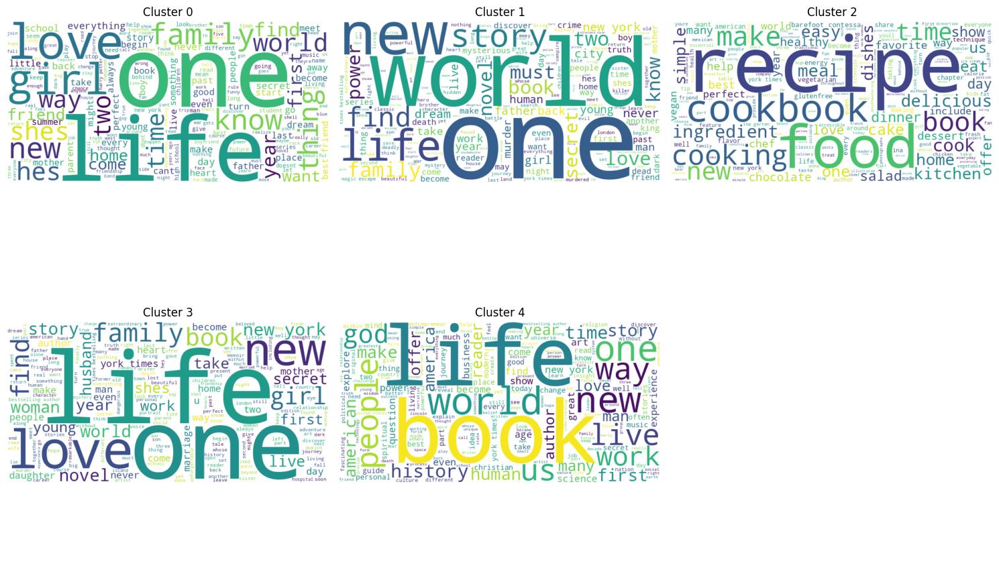

In [147]:
# 1. Importations
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import pandas as pd
import numpy as np

# 2. Préparation des données pour le Word Cloud
# Concaténer le texte de chaque cluster
cluster_texts = {}
num_clusters = data['cluster'].nunique()

for i in range(num_clusters):
    cluster_data = data[data['cluster'] == i]
    # 'combined_text' doit être une chaîne de caractères pour WordCloud
    text = ' '.join(cluster_data['combined_text'].astype(str))
    cluster_texts[i] = text

# 3. Création et affichage des Word Clouds
# Définir le nombre de sous-graphiques (Word Clouds)
n_cols = 3
n_rows = int(np.ceil(num_clusters / n_cols))

fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
axes = axes.flatten()

for i, ax in enumerate(axes):
    if i < num_clusters:
        text = cluster_texts[i]
        
        # Créer l'objet WordCloud
        wordcloud = WordCloud(
            width=800,
            height=400,
            background_color='white',
            colormap='viridis'  # Choix de la palette de couleurs
        ).generate(text)
        
        # Afficher le Word Cloud dans le sous-graphique
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(f'Cluster {i}')
        ax.axis('off')  # Cacher les axes

    else:
        # Cacher les sous-graphiques vides si le nombre total n'est pas un multiple de 3
        ax.axis('off')

plt.tight_layout()
plt.show()